In [ ]:
# if running locally, comment these lines
#!pip uninstall tensorflow
!pip install tensorflow==1.15

     |████████████████████████████████| 412.3 MB 25 kB/s 
     |████████████████████████████████| 503 kB 48.7 MB/s 
     |████████████████████████████████| 3.8 MB 31.6 MB/s 
     |████████████████████████████████| 50 kB 6.7 MB/s 
  Created wheel for gast: filename=gast-0.2.2-py3-none-any.whl size=7554 sha256=e129301811ca116bf168a4499751305d9b4dcc64c29977c066516e5725fbd349
  Stored in directory: /root/.cache/pip/wheels/21/7f/02/420f32a803f7d0967b48dd823da3f558c5166991bfd204eef3
Successfully built gast
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.8.0
    Uninstalling tensorflow-estimator-2.8.0:
      Successfully uninstalled tensorflow-estimator-2.8.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.8.0
    Uninstalling tensorboard-2.8.0:
      Successfully uninstalled tensorboard-2.8.0
  Attempting uninstall: gast
    Found existing installation: gast 0.5.3
    Uninstalling gast-0.5.3:
      Succes

In [ ]:
import tensorflow as tf

print(tf.__version__)
tf.enable_eager_execution()

1.15.0


In [ ]:
# if running locally, comment these lines
!wget https://www.dropbox.com/s/4tjix8rhyzxpc28/dataset.tar.gz
!wget https://www.dropbox.com/s/zj1v8n5href2mtu/tboard_logs.tar.gz
!tar -xvzf dataset.tar.gz
!tar -xvzf tboard_logs.tar.gz

--2022-03-04 11:25:59--  https://www.dropbox.com/s/4tjix8rhyzxpc28/dataset.tar.gz
Resolving www.dropbox.com (www.dropbox.com)... 162.125.3.18, 2620:100:601b:18::a27d:812
Connecting to www.dropbox.com (www.dropbox.com)|162.125.3.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/4tjix8rhyzxpc28/dataset.tar.gz [following]
--2022-03-04 11:26:00--  https://www.dropbox.com/s/raw/4tjix8rhyzxpc28/dataset.tar.gz
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc50f76bb483078ca3d0c847fd8c.dl.dropboxusercontent.com/cd/0/inline/Bg1dfUJoODk2dINqiyrGkigRDUUE3Xq2qol736PO5Myg0QvSsEn3jissC9x8MqEbtcCZtEwR5SYhHaOWEFY-1l7qmI0FZ-pffBW6tVa-NIafo9ZeZ5f03UGXOFdvasEffdsbkZT2Xa0Jbdcyz_nkCApf/file# [following]
--2022-03-04 11:26:00--  https://uc50f76bb483078ca3d0c847fd8c.dl.dropboxusercontent.com/cd/0/inline/Bg1dfUJoODk2dINqiyrGkigRDUUE3Xq2qol736PO5Myg0QvSsEn3jissC9x8MqEbtcCZtEwR5SYhHaOWEFY-

In [ ]:
# if running locally, comment these lines
!mkdir src
!wget https://raw.githubusercontent.com/sthalles/face-similarity/master/src/contrastive.py
!wget https://raw.githubusercontent.com/sthalles/face-similarity/master/src/cyclical_lr.py
!wget https://raw.githubusercontent.com/sthalles/face-similarity/master/src/pre_processing.py
!wget https://raw.githubusercontent.com/sthalles/face-similarity/master/src/utils.py
!mv contrastive.py ./src/
!mv cyclical_lr.py ./src/
!mv pre_processing.py ./src/
!mv utils.py ./src/

--2022-03-04 11:26:10--  https://raw.githubusercontent.com/sthalles/face-similarity/master/src/contrastive.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 310 [text/plain]
Saving to: ‘contrastive.py’

contrastive.py      100%[===================>]     310  --.-KB/s    in 0s      

2022-03-04 11:26:10 (13.2 MB/s) - ‘contrastive.py’ saved [310/310]

--2022-03-04 11:26:11--  https://raw.githubusercontent.com/sthalles/face-similarity/master/src/cyclical_lr.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1153 (1.1K) [text/plain]


In [ ]:
# if running locally, comment these lines
!mkdir model
!wget https://raw.githubusercontent.com/sthalles/face-similarity/master/model/densenet.py
!mv densenet.py ./model/

--2022-03-04 11:26:12--  https://raw.githubusercontent.com/sthalles/face-similarity/master/model/densenet.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5184 (5.1K) [text/plain]
Saving to: ‘densenet.py’

densenet.py         100%[===================>]   5.06K  --.-KB/s    in 0s      

2022-03-04 11:26:12 (41.5 MB/s) - ‘densenet.py’ saved [5184/5184]



In [ ]:
import os
from model.densenet import DenseNet
from src.pre_processing import *
import matplotlib.pyplot as plt
from src.contrastive import contrastive_loss
import json
from src.utils import Dotdict

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



In [ ]:
work_dir = './tboard_logs'
model_id = 31911
test_dataset_path = './dataset/test_v2.tfrecords'

In [ ]:
checkpoint_dir = os.path.join(work_dir, str(model_id))

# load training metadata (setup path if necessary)
with open(checkpoint_dir + '/meta.json', 'r') as fp:
    training_args = Dotdict(json.load(fp))

In [ ]:
tfe = tf.contrib.eager
test_filenames = [test_dataset_path]
test_dataset = tf.data.TFRecordDataset(test_filenames)
test_dataset = test_dataset.map(tf_record_parser)
test_dataset = test_dataset.map(random_resize_and_crop)
test_dataset = test_dataset.map(normalizer)
test_dataset = test_dataset.shuffle(1000)
test_dataset = test_dataset.batch(8)



Instructions for updating:
Use `tf.cast` instead.



Instructions for updating:
Use `tf.cast` instead.


In [ ]:
args = {"k": training_args.growth_rate,
        "weight_decay": training_args.l2_regularization,
        "num_outputs": training_args.num_outputs,
        "units_per_block": training_args.units_per_block,
        "momentum": training_args.momentum,
        "epsilon": training_args.epsilon,
        "initial_pool": training_args.initial_pool}

model = DenseNet(**args)

In [ ]:
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
root = tfe.Checkpoint(model=model,
                      optimizer_step=tf.train.get_or_create_global_step())

try:
    root.restore(tf.train.latest_checkpoint(checkpoint_dir))
    print("Model {} successfully loaded.".format(model_id))
except:
    print("Error loading model: {}".format(FLAGS.model_id))

Model 31911 successfully loaded.


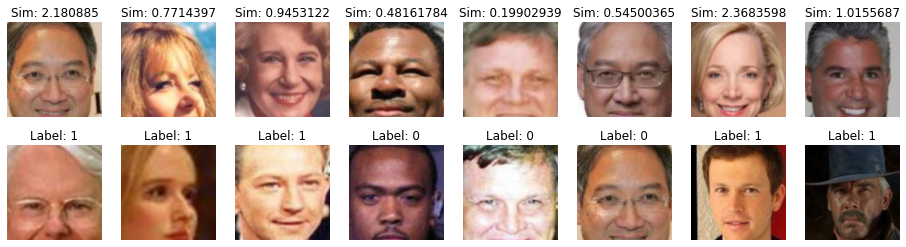

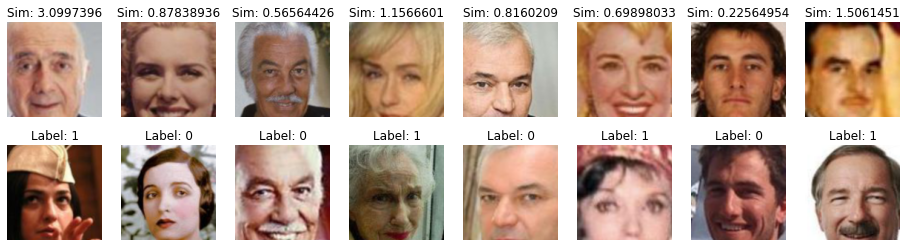

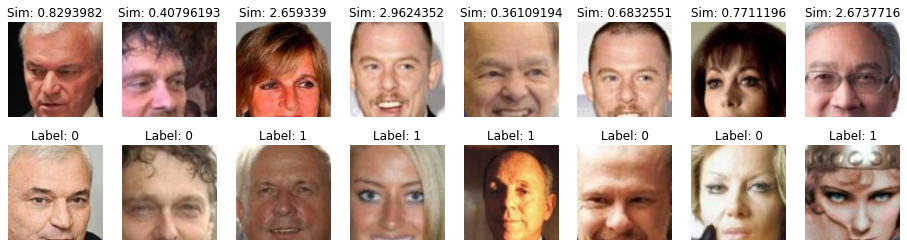

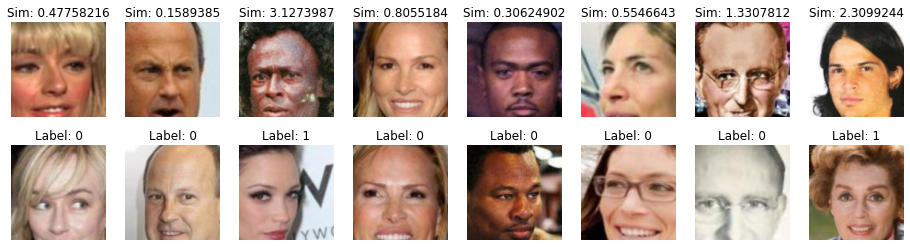

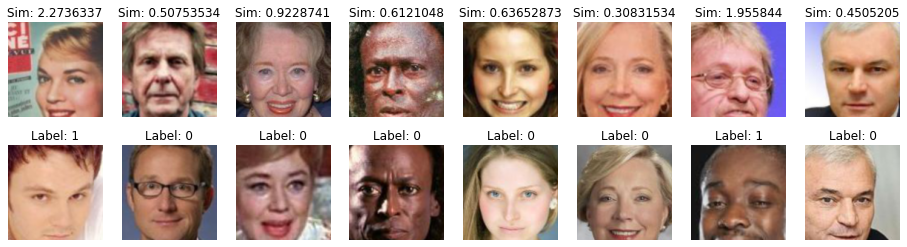

...

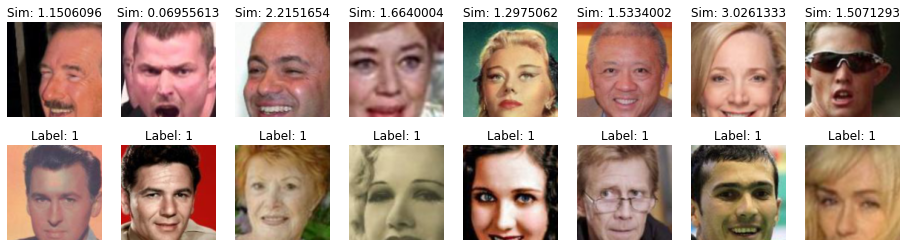

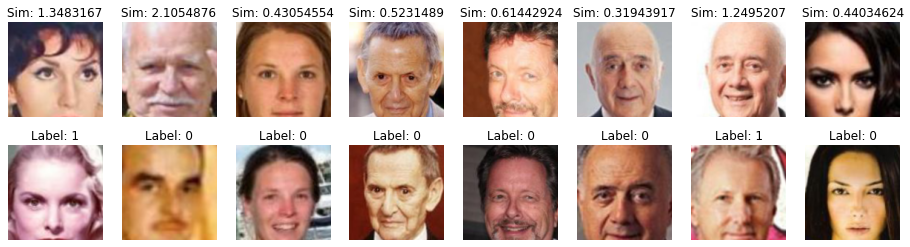

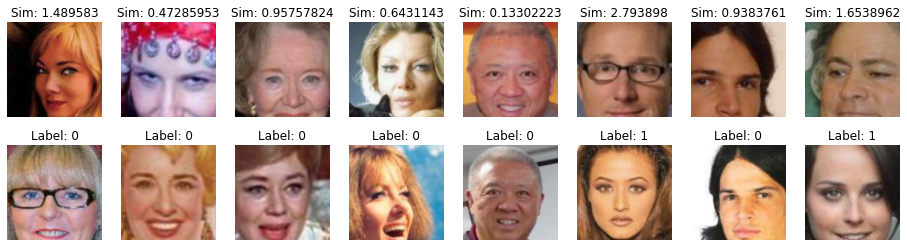

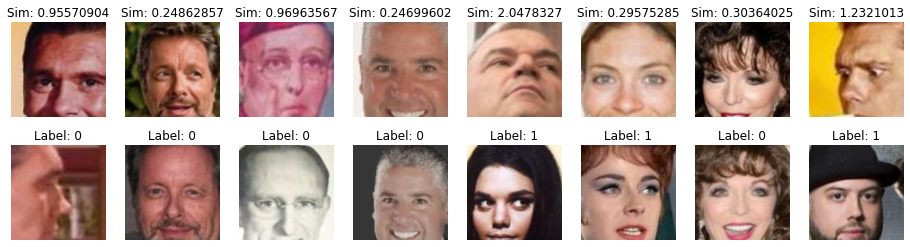

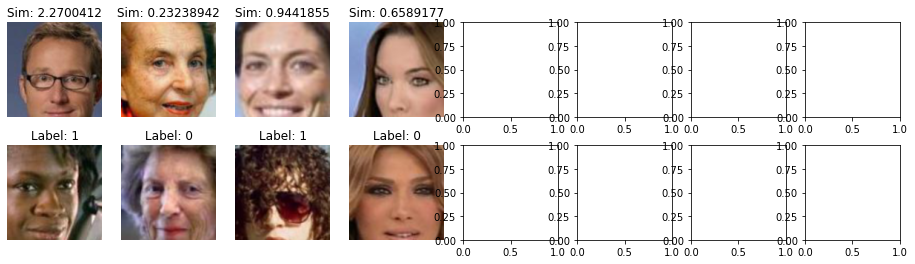

Mean similarity 0.6923186779022217 Mean Std: 0.3875460922718048.
Mean dissimilarity 1.801786184310913 Mean Std: 0.758018970489502.


In [ ]:
mean_similarity = []
mean_dissimilarity = []

for (batch, (Xi, Xj, label)) in enumerate(test_dataset):

    with tf.contrib.summary.record_summaries_every_n_global_steps(100):

        GX1 = model(Xi, training=False)
        GX2 = model(Xj, training=False)
        _, Dw = contrastive_loss(GX1, GX2, label, margin=2.)

        f, axarr = plt.subplots(2, 8, figsize=(16,4))
        f.subplots_adjust(hspace=0.3)

        for i in range(label.shape[0]):

            Si = denormalize(Xi[i]).numpy()
            Sj = denormalize(Xj[i]).numpy()

            if label[i].numpy() == 0:
                mean_similarity.append(Dw[i])
            else:
                mean_dissimilarity.append(Dw[i])

            axarr[0, i].set_title('Sim: ' + str(Dw[i].numpy()))
            axarr[0,i].imshow(np.squeeze(Si))
            axarr[0,i].set_axis_off()

            axarr[1,i].set_title("Label: " + str(label[i].numpy()))
            axarr[1,i].imshow(np.squeeze(Sj))
            axarr[1,i].set_axis_off()

        plt.show()

mean_std_similarity_np = np.std(mean_similarity)
mean_std_dissimilarity_np = np.std(mean_dissimilarity)
mean_similarity_np = np.mean(mean_similarity)
mean_dissimilarity_np = np.mean(mean_dissimilarity)

print("Mean similarity {0} Mean Std: {1}.".format(mean_similarity_np, mean_std_similarity_np))
print("Mean dissimilarity {0} Mean Std: {1}.".format(mean_dissimilarity_np, mean_std_dissimilarity_np))

In [ ]:
test_dataset

<DatasetV1Adapter shapes: ((?, 128, 128, ?), (?, 128, 128, ?), (?,)), types: (tf.float32, tf.float32, tf.int32)>

In [ ]:
mnist = tf.keras.datasets.mnist

(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train, x_test = x_train / 255.0, x_test / 255.0

In [ ]:
y_train[1]

0

In [ ]:
x_train.shape

(60000, 28, 28)

In [ ]:
#load_image = tf.keras.preprocessing.image.load_img("/content/new_test/P1.jpg")

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


image = cv2.imread('/content/new_test/P1.jpg', 1)

In [ ]:
image.shape

(960, 1440, 3)

In [ ]:
new_array = cv2.resize(image, (28,28))

In [ ]:
new_array.shape

(28, 28, 3)

In [ ]:
x_train = new_array/255.0

In [ ]:
import imageio
image1 = imageio.imread('/content/new_test/P1.jpg')
image2= imageio.imread('/content/new_test/P2.jpg')

In [ ]:
image1.shape

(960, 1440, 3)

In [ ]:
import dlib
from skimage.transform import resize
detector = dlib.get_frontal_face_detector()

In [ ]:
def detect_crop_and_resize(image1, output_shape=(128,128,3)):
    dets = detector(image1, 1)
    print("Number of faces detected: {}".format(len(dets)))
    for i, d in enumerate(dets):
        print("Detection {}: Left: {} Top: {} Right: {} Bottom: {}".format(
            i, d.left(), d.top(), d.right(), d.bottom()))

        width = d.right() - d.left()
        height = d.bottom() - d.top()
        
        if width > height:
            height = width
        else:
            width = height
        
        x, y = d.top(), d.left()
        
        increase_factor = 0.8
        increase = int(increase_factor * height)
        print("Old height:", height, "New height:", height+increase)
        margin = increase // 2
        
        increment = margin // 4
        cropped_face = image1[x-margin:x+height+margin, y-margin:y+width+margin,]
        cropped_face = resize(cropped_face, output_shape)
        plt.imshow(cropped_face)
        plt.show()
        return cropped_face

Number of faces detected: 1
Detection 0: Left: 646 Top: 409 Right: 914 Bottom: 676
Old height: 268 New height: 482


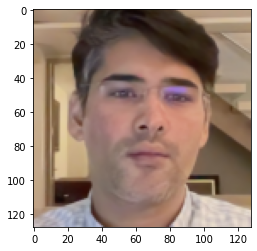

Number of faces detected: 1
Detection 0: Left: 1611 Top: 872 Right: 2277 Bottom: 1538
Old height: 666 New height: 1198


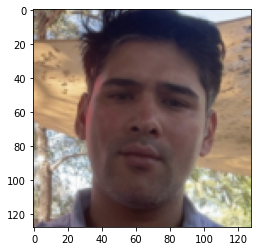

In [ ]:
image1 = detect_crop_and_resize(image1)
image2 = detect_crop_and_resize(image2)

In [ ]:
Xi = np.expand_dims(image1,0).astype(np.float32)
Xj = np.expand_dims(image2,0).astype(np.float32)

In [ ]:
def normalize(Xi):
    return 2 * (Xi - 0.5)

def denormalize(Xi):
    return (Xi / 2 ) + 0.5

In [ ]:
checkpoint_dir = "./tboard_logs"
model_id = "31911"
checkpoint_dir = os.path.join(checkpoint_dir, model_id)

# load training metadata
with open(checkpoint_dir + '/meta.json', 'r') as fp:
    training_args = Dotdict(json.load(fp))

args = {"k": training_args.growth_rate,
        "weight_decay": training_args.l2_regularization,
        "num_outputs": training_args.num_outputs,
        "units_per_block": training_args.units_per_block,
        "momentum": training_args.momentum,
        "epsilon": training_args.epsilon,
        "initial_pool": training_args.initial_pool}
print(args)

{'k': 32, 'weight_decay': 0.01, 'num_outputs': 32, 'units_per_block': [6, 12, 24, 16], 'momentum': 0.997, 'epsilon': 0.001, 'initial_pool': True}


In [ ]:
model = DenseNet(**args)

checkpoint = tf.train.Checkpoint(model=model)
status = checkpoint.restore(tf.train.latest_checkpoint('/content/tboard_logs/31911/meta.json'))

In [ ]:
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
root = tfe.Checkpoint(model=model,
                      optimizer_step=tf.train.get_or_create_global_step())

try:
    root.restore(tf.train.latest_checkpoint(checkpoint_dir))
    print("Model {} successfully loaded.".format(model_id))
except:
    print("Error loading model: {}".format(FLAGS.model_id))

Model 31911 successfully loaded.


In [ ]:
eps = 1e-7
GX1 = model(tf.constant(normalize(Xi)), training=False)
GX2 = model(tf.constant(normalize(Xj)), training=False)
Dw = tf.sqrt(eps + tf.reduce_sum(tf.square(GX1 - GX2), 1))

In [ ]:

with tf.Session() as session:
    # Use the Session to restore variables, or initialize them if
    # tf.train.latest_checkpoint returned None.
    status.run_restore_ops(session)
    distance = session.run(Dw)
    
    f, axarr = plt.subplots(2, 1, figsize=(16,4))
    f.subplots_adjust(hspace=0.3)
    
    axarr[0].set_title('Sim: ' + str(distance))
    print('Similariry: ' + str(distance))
    axarr[0].imshow(np.squeeze(Xi))
    axarr[0].set_axis_off()
    
    axarr[1].imshow(np.squeeze(Xj))
    axarr[1].set_axis_off()

AssertionError: ignored